Data shape for sierra_leone: (525600, 19)


,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
0,2021-10-30 00:01,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.1,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
1,2021-10-30 00:02,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
2,2021-10-30 00:03,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
3,2021-10-30 00:04,-0.7,0.0,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.1,22.3,22.6,NaN
4,2021-10-30 00:05,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN


Numeric summary:
                  GHI            DNI            DHI           ModA  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      201.957515     116.376337     113.720571     206.643095   
std       298.495150     218.652659     158.946032     300.896893   
min       -19.500000      -7.800000     -17.900000       0.000000   
25%        -2.800000      -0.300000      -3.800000       0.000000   
50%         0.300000      -0.100000      -0.100000       3.600000   
75%       362.400000     107.000000     224.700000     359.500000   
max      1499.000000     946.000000     892.000000    1507.000000   

                ModB           Tamb             RH             WS  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      198.114691      26.319394      79.448857       1.146113   
std       288.889073       4.398605      20.520775       1.239248   
min         0.000000      12.300000       9.900000       0.000000   
25%         0.0

C:\Users\Y.com\AppData\Local\Temp\ipykernel_21840\4118530277.py:53: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(median_val, inplace=True)


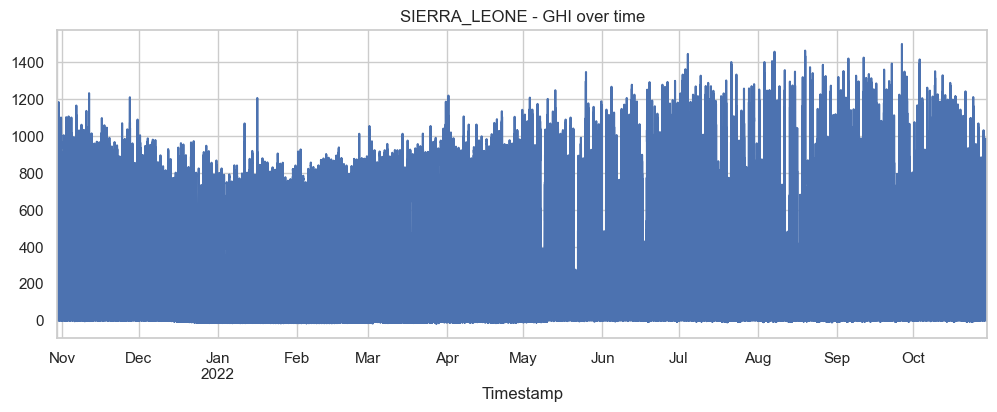

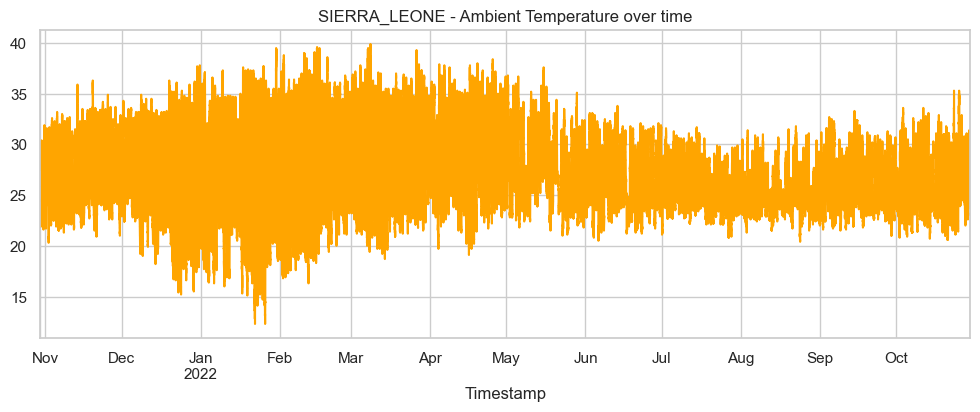

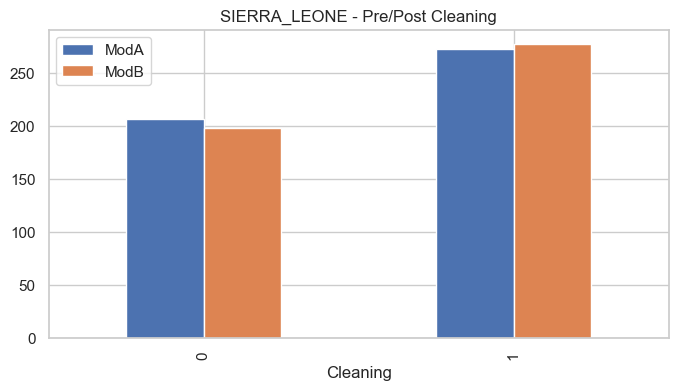

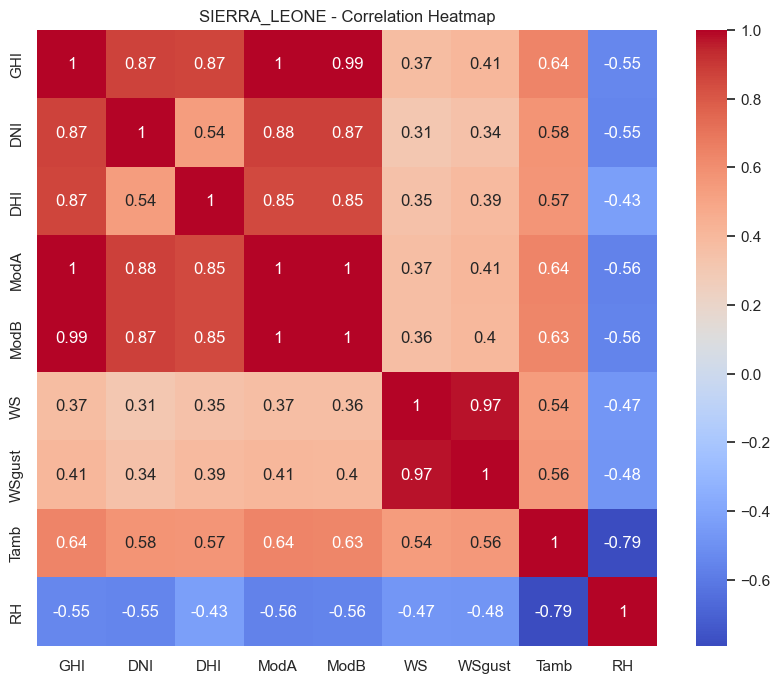

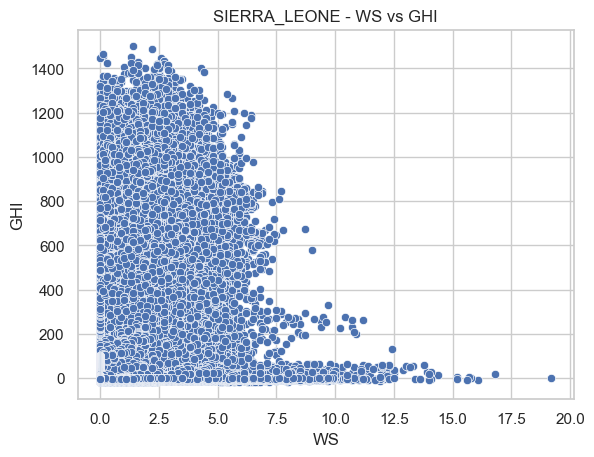

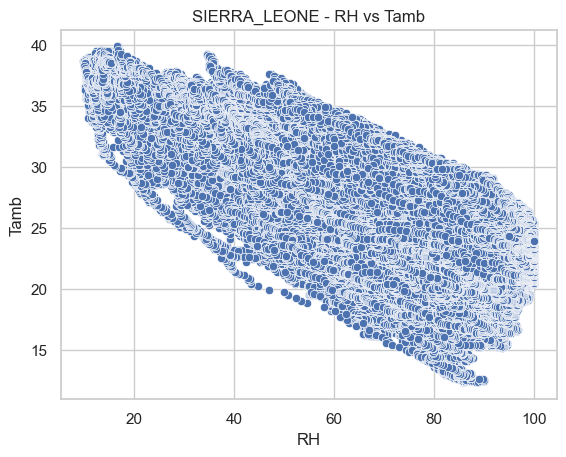

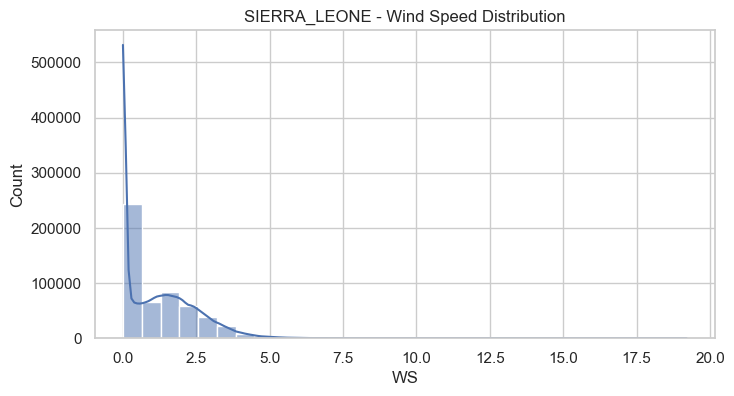

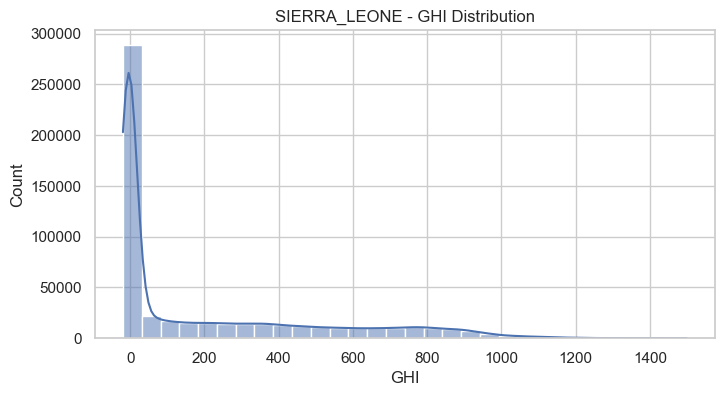

c:\Users\Y.com\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


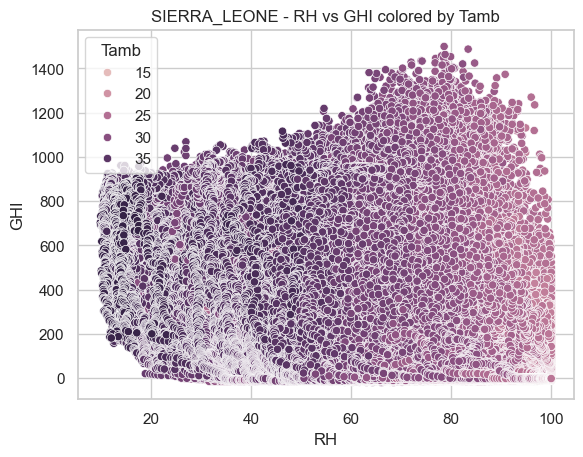

Cleaned data exported to ../data/sierra_leone_clean.csv


In [1]:
# =========================
# Task 2: Country EDA Template
# =========================

# 0. Setup
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.express as px
import os

# Set display options
pd.set_option('display.max_columns', None)
sns.set(style='whitegrid')

# -------------------------
# 1. Load Data
# -------------------------
country = 'sierra_leone'  
raw_path = f'../data/{country}.csv'  # Ensure your raw CSVs are here
if not os.path.exists(raw_path):
    raise FileNotFoundError(f"{raw_path} not found. Please place your raw CSV there.")

df = pd.read_csv(raw_path)
print(f"Data shape for {country}: {df.shape}")
display(df.head())

# -------------------------
# 2. Summary Statistics & Missing Values
# -------------------------
print("Numeric summary:\n", df.describe())
print("\nMissing values:\n", df.isna().sum())

# List columns with >5% missing
missing_pct = df.isna().mean() * 100
print("\nColumns with >5% missing values:")
print(missing_pct[missing_pct > 5])

# -------------------------
# 3. Outlier Detection & Cleaning
# -------------------------
cols_to_check = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']

z_scores = np.abs(stats.zscore(df[cols_to_check], nan_policy='omit'))
outliers = (z_scores > 3)
print("\nNumber of outliers per column:")
print(pd.DataFrame(outliers).sum())

for col in cols_to_check:
    median_val = df[col].median()
    df[col].fillna(median_val, inplace=True)

# -------------------------
# 4. Time Series Analysis
# -------------------------
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df.set_index('Timestamp', inplace=True)

plt.figure(figsize=(12,4))
df['GHI'].plot(title=f"{country.upper()} - GHI over time")
plt.show()

plt.figure(figsize=(12,4))
df['Tamb'].plot(title=f"{country.upper()} - Ambient Temperature over time", color='orange')
plt.show()

# -------------------------
# 5. Cleaning Impact
# -------------------------
if 'Cleaning' in df.columns:
    df.groupby('Cleaning')[['ModA', 'ModB']].mean().plot(
        kind='bar', figsize=(8,4), title=f"{country.upper()} - Pre/Post Cleaning"
    )
    plt.show()

# -------------------------
# 6. Correlation & Relationship Analysis
# -------------------------
corr_cols = ['GHI','DNI','DHI','ModA','ModB','WS','WSgust','Tamb','RH']
plt.figure(figsize=(10,8))
sns.heatmap(df[corr_cols].corr(), annot=True, cmap='coolwarm')
plt.title(f"{country.upper()} - Correlation Heatmap")
plt.show()

sns.scatterplot(data=df, x='WS', y='GHI')
plt.title(f"{country.upper()} - WS vs GHI")
plt.show()

sns.scatterplot(data=df, x='RH', y='Tamb')
plt.title(f"{country.upper()} - RH vs Tamb")
plt.show()

# -------------------------
# 7. Wind & Distribution Analysis
# -------------------------
plt.figure(figsize=(8,4))
sns.histplot(df['WS'], bins=30, kde=True)
plt.title(f"{country.upper()} - Wind Speed Distribution")
plt.show()

plt.figure(figsize=(8,4))
sns.histplot(df['GHI'], bins=30, kde=True)
plt.title(f"{country.upper()} - GHI Distribution")
plt.show()

# -------------------------
# 8. Temperature Analysis
# -------------------------
sns.scatterplot(data=df, x='RH', y='GHI', hue='Tamb')
plt.title(f"{country.upper()} - RH vs GHI colored by Tamb")
plt.show()

# -------------------------
# 9. Bubble Chart
# -------------------------
if 'RH' in df.columns:
    fig = px.scatter(df, x='Tamb', y='GHI', size='RH', color='RH',
                     title=f"{country.upper()} - GHI vs Tamb with RH bubble size")
    fig.show()

# -------------------------
# 10. Export Cleaned Data
# -------------------------
os.makedirs('../data', exist_ok=True)
cleaned_path = f'../data/{country}_clean.csv'
df.reset_index().to_csv(cleaned_path, index=False)
print(f"Cleaned data exported to {cleaned_path}")
